# Wine Dataset Analysis

  ## Task Description
The role of a data scientist was undertaken to complete the full data science pipeline using a selected dataset. A single dataset was chosen from the provided options, and an investigative question of interest was explored through both data exploration and modelling.

The project followed the data science pipeline outlined in the module and lab sessions:

* An interesting question was formulated.

* Relevant data was obtained and prepared for analysis.

* The dataset was explored to identify trends, patterns, and insights.

* Appropriate models were developed and evaluated to address the research question.

* The results were clearly communicated through visualizations and written interpretation.

All analysis and findings were presented in a structured Jupyter Notebook, formatted as a report integrating code, outputs, and discussion throughout the workflow.

# 1. Introduction

### Overview and Background
The dataset we have includes information about different types of wine grown in the same area in Italy. The information was collected through a chemical analysis of each type of wine, looking at thirteen different components that make up the characteristics of each. I have chosen this specific dataset because I feel the attributes are those that I can understand and are well colerated with each other. This connection can make results easier to understand and explain.

People have been making wine for thousands of years, starting with ancient civilizations in Mesopotamia, Egypt, Greece, and Rome dating back to almost 6000 B.C. They figured out that grape juice would turn into wine if left in containers, and they found ways to improve the quality of the wine over time. Wines grown in different areas can differ in taste, aroma, and body due to differences in climate, soil, grape variety, winemaking techniques, and local traditions and regulations, because these wines have been cultivated in the same region, no major differences can be expected.

Wine production has spread to many parts of the world, including the New World in the 18th and 19th centuries. Today, wine-making is a global industry, with wineries and vineyards located in countries around the world. Wine is enjoyed by millions of people and continues to be an important part of many cultures and cuisine. In addition, Italy, since 2014 has been the number one wine producer in the world.

### Proposed solution 
The provided dataset and Python notebook offer a valuable resource for analyzing the chemical makeup of different types of wine and identifying where it came from. By examining the thirteen fundamental attributes that make up each wine's unique characteristics using models such as a decision tree and confusion matrix, we can better understand and break down the history of wine and appreciate the many cultural and culinary traditions associated with this ancient beverage and see whether the chemical components of wine differ in percentage depending on the area in which it is produced.

# 2. Data Description and Exploratory Analysis

### Data Description 

The dataset provided includes 13 attribues and 1 output attribue ("Target")
The 178 instances have been classified into one of 3 different classes based on who produced the wine. 

These attributes represent the chemical makeup of wines and can provide insights into their quality and origin. Below is a brief description of each attribute:

Target - this is the type of wine being analyzed, with three possible values (1, 2, or 3) representing three different types of wine.

Alcohol - this measures the percentage of alcohol content in the wine and can affect the wine's flavor, aroma, and texture.

Malic acid - this is an organic acid found in grapes and can contribute to a wine's acidity and tartness.

Ash - this represents the inorganic mineral content of the wine, including potassium, calcium, and magnesium.

Alcalinity of ash - this measures the wine's alkalinity, which can affect its taste and texture.

Magnesium - this is one of the minerals measured in the ash content and can contribute to the wine's color and flavor.

Total phenols - this measures the total amount of phenolic compounds in the wine, which can contribute to its antioxidant properties and affect its color, aroma, and flavor.

Flavanoids - this is a subclass of phenolic compounds that contribute to a wine's bitterness, astringency, and color.

Nonflavanoid phenols - this is another subclass of phenolic compounds that can contribute to a wine's aroma, color, and antioxidant properties.

Proanthocyanins - these are a type of flavanoid that contribute to a wine's bitterness, astringency, and color stability.

Color intensity - this measures the wine's color saturation and can provide insights into its age and quality.

Hue - this measures the wine's color shade, from red to yellow, and can also provide insights into its age and quality.

OD280/OD315 of diluted wines - this measures the absorbance of light by the wine, which can provide insights into its protein and alcohol content.

Proline - this is an amino acid found in grapes and can contribute to a wine's flavor and texture.

Overall, these attributes are interconnected and provide a comprehensive view of a wine's chemical makeup, which can help identify its origin, age, and quality.

# Exploratory analysis

### Importing packages and loading data

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import sklearn as sk
import seaborn as sns

In [1]:
import pandas as pd
wine = pd.read_csv("wine.csv")

feature_frame = wine.drop(["Target"], axis=1)
label_frame = wine["Target"]

print(feature_frame)
print(label_frame)



     Alcohol  Malic acid   Ash  Alcalinity of ash  Magnesium  Total phenols  \
0      14.23        1.71  2.43               15.6        127           2.80   
1      13.20        1.78  2.14               11.2        100           2.65   
2      13.16        2.36  2.67               18.6        101           2.80   
3      14.37        1.95  2.50               16.8        113           3.85   
4      13.24        2.59  2.87               21.0        118           2.80   
..       ...         ...   ...                ...        ...            ...   
173    13.71        5.65  2.45               20.5         95           1.68   
174    13.40        3.91  2.48               23.0        102           1.80   
175    13.27        4.28  2.26               20.0        120           1.59   
176    13.17        2.59  2.37               20.0        120           1.65   
177    14.13        4.10  2.74               24.5         96           2.05   

     Flavanoids  Nonflavanoid phenols  Proanthocyan

# Data Distribution

In this section, the data has been grouped by "Target" as it is the output attribue

In [2]:
# applying groupby() function to
# group the data on team value.
groups = wine.groupby('Target')
 
# in all the groups formed.
group1 = groups.get_group(1)
group2 = groups.get_group(2)
group3 = groups.get_group(3)

count = label_frame.value_counts()
group = (count/wine.shape[0] * 100)

print(group)

print(count)

2    39.887640
1    33.146067
3    26.966292
Name: Target, dtype: float64
2    71
1    59
3    48
Name: Target, dtype: int64


## Pie Chart
 The following pie chart provides a visual representation of the distribution of data recorded for each cultivator. As illustrated, the majority of the data was collected from Target 1, followed by Target 2, with the least amount of data recorded from Target 3.

([<matplotlib.patches.Wedge at 0x233b0c7ed90>,
 [Text(0.3436094134029147, 1.0449557746722609, 'group 1'),
  Text(-1.0106064575192055, -0.4343668818182187, 'group 2'),
  Text(0.7283164304833661, -0.8243513674932361, 'group 3')],
 [Text(0.18742331640158982, 0.5699758770939605, '40%'),
  Text(-0.5512398859195666, -0.23692739008266472, '33%'),
  Text(0.39726350753638145, -0.44964620045085607, '27%')])

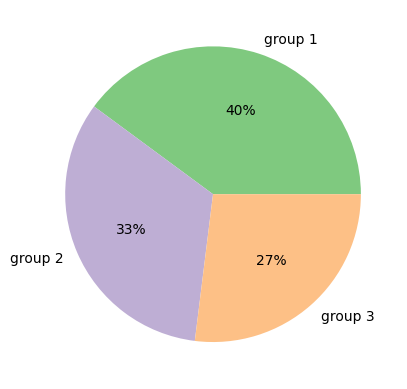

In [4]:
import seaborn as sns
import matplotlib.pyplot as plt

palette_color = sns.color_palette("Accent")


plt.pie(count, labels= ["group 1", "group 2","group 3"], colors=palette_color, autopct='%1.0f%%')

# Data Visualisation (Scatterplot Chart)
Displayed below is a scatterplot chart that offers a comprehensive and detailed comparison of all the data points at our disposal. This method has been thoughtfully selected for its ability to visually showcase the variations and distribution patterns among the provided information. By utilizing this technique, we can gain a better understanding of the discrepancies and similarities between the various data points, allowing us to make more informed decisions based on the insights derived from this analysis.

<Figure size 700x700 with 0 Axes>

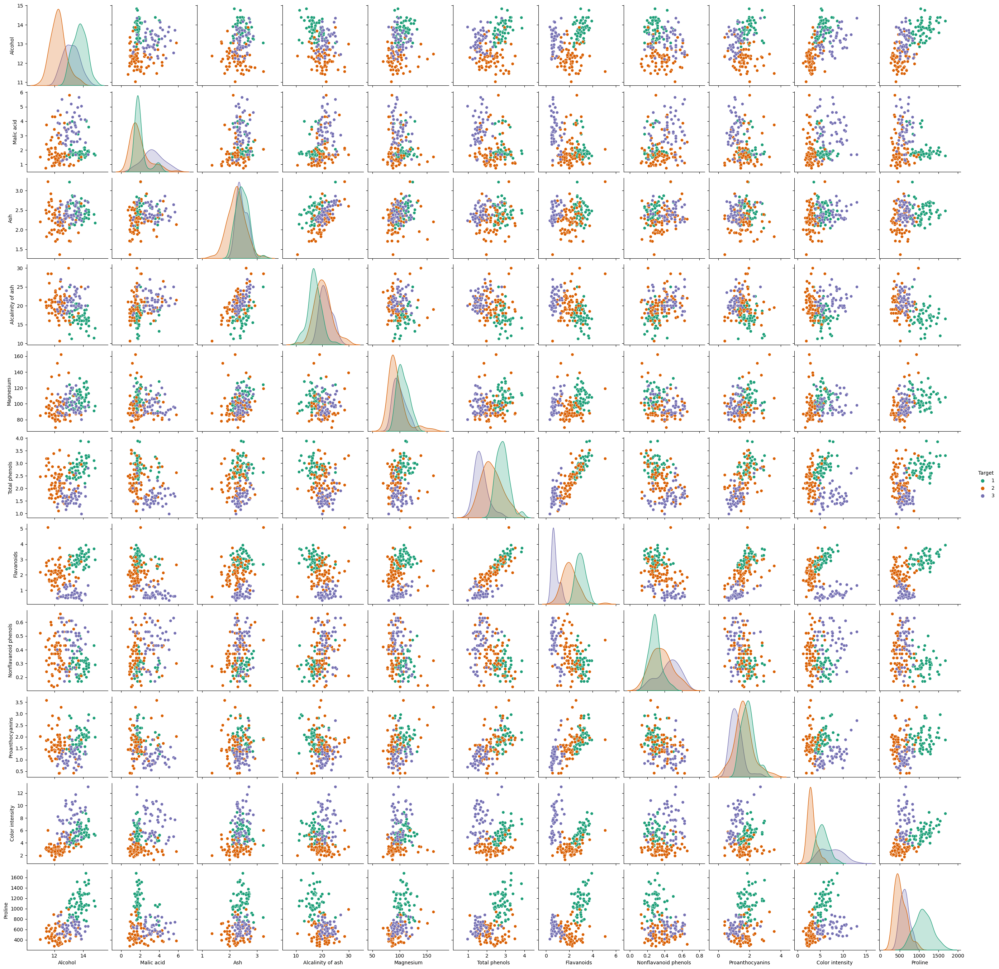

<Figure size 700x700 with 0 Axes>

In [5]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn as sk
import seaborn as sns

wine = pd.read_csv("wine.csv")

wine = wine[["Alcohol","Malic acid", "Ash", "Alcalinity of ash", "Magnesium", "Total phenols", "Flavanoids", "Nonflavanoid phenols", "Proanthocyanins", "Color intensity",  "Proline", "Target" ]]

sns.color_palette("crest", as_cmap=True)
sns.pairplot(wine, hue= "Target", palette="Dark2")

plt.figure(figsize=(7,7))


Given the volume of data at hand, analyzing and comprehending the variations of each attribute can prove to be a challenging task. However, by analysing areas of the scatterplot chart, certain patterns and distributions among the data points can be easily discerned with clarity. This approach allows for a more efficient and streamlined analysis of the data, enabling us to gain valuable insights that might have otherwise been overlooked. The following scatter plots are illustrations of the data attributes that had the most linear and vivid visualizations.  

Below is a scatterplot that depicts the correlation between flavonoids and total phenols for each target group. It is evident that target 3 exhibits the highest percentage of flavonoids, while target 1 has the highest total amount of phenols. Notably, target 1 outperforms the other targets with the highest overall percentage of both flavonoids and total phenols. 

<Figure size 700x700 with 0 Axes>

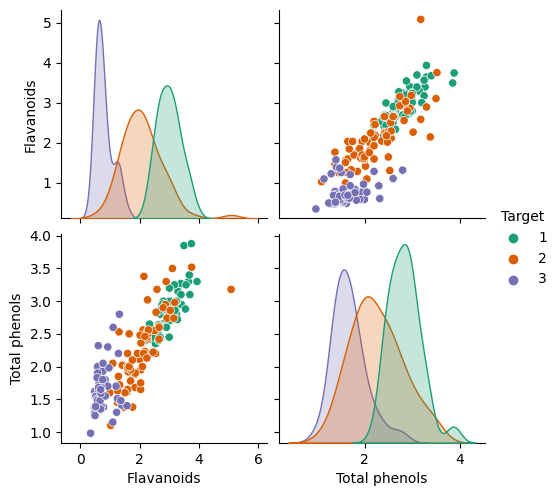

<Figure size 700x700 with 0 Axes>

In [19]:
wine = pd.read_csv("wine.csv")

wine1 = wine[["Flavanoids", "Total phenols", "Target"]]

sns.color_palette("rocket", as_cmap=True)
sns.pairplot(wine1, hue= "Target", palette="Dark2")

plt.figure(figsize=(7,7))


Below is a scatterplot that visually depicts the correlation between proline and color intensity for each target group. As per the graph, it is evident that target 2 exhibits the highest level of color intensity and proline in comparison to the other target groups. Notably, target 1 outperforms the other targets with the highest overall percentage of both color intensity and proline. 

<Figure size 700x700 with 0 Axes>

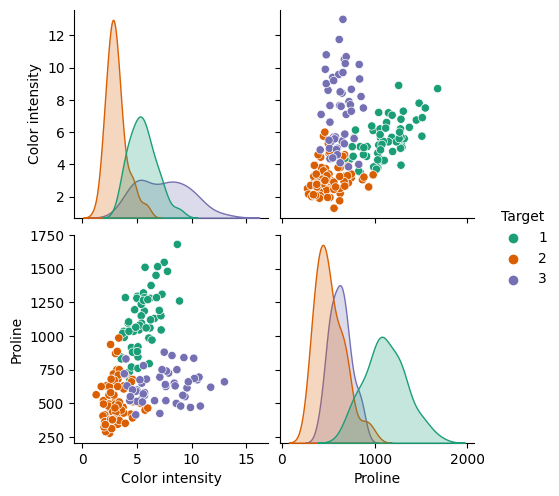

<Figure size 700x700 with 0 Axes>

In [20]:
wine = pd.read_csv("wine.csv")

wine2 = wine[["Color intensity", "Proline", "Target"]]

sns.color_palette("rocket", as_cmap=True)
sns.pairplot(wine2, hue= "Target", palette="Dark2")

plt.figure(figsize=(7,7))


Below is a scatterplot that visually represents the correlation between Proline and Alcohol for each target group. The graph shows that target 2 outperforms the other targets in terms of the highest percentage of alcohol and Proline independently.However, when comparing the relationship between Proline and Alcohol together, target 1 emerges as the superior target with the highest percentage. 

<Figure size 700x700 with 0 Axes>

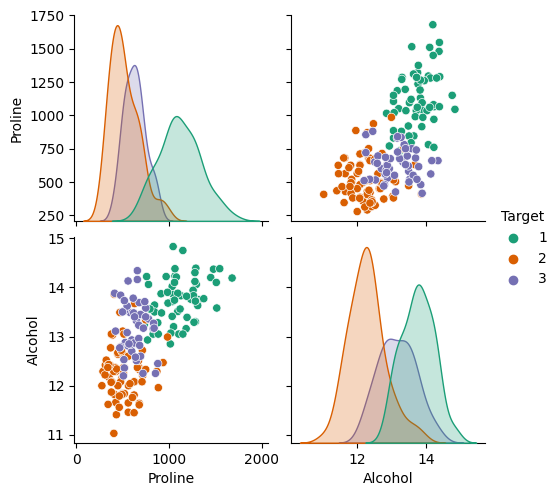

<Figure size 700x700 with 0 Axes>

In [21]:
wine = pd.read_csv("wine.csv")

wine3 = wine[["Proline", "Alcohol", "Target"]]

sns.color_palette("rocket", as_cmap=True)
sns.pairplot(wine3, hue= "Target", palette="Dark2")

plt.figure(figsize=(7,7))

# Line plot
A line plot, is a graphical representation of data that displays a series of data points on a number line. Each data point is shown as a dot or a mark above the corresponding value on the number line. The dots are connected by lines, which show the pattern or trend of the data over time or across different variables. Line plots are commonly used to  identify trends and patterns in data, and to visualize the distribution of data.

The presented line plot showcases the intensity levels of color within different target groups. A careful examination of the plot reveals that target group 3 exhibited the highest color intensity levels compared to the other groups. Based on this observation, it can be inferred that wines with high color intensity levels are more likely to have originated from the third target group. This finding may have significant implications in the wine industry as it could assist in the identification of wines with desired color intensity levels.

<Axes: ylabel='Color intensity'>

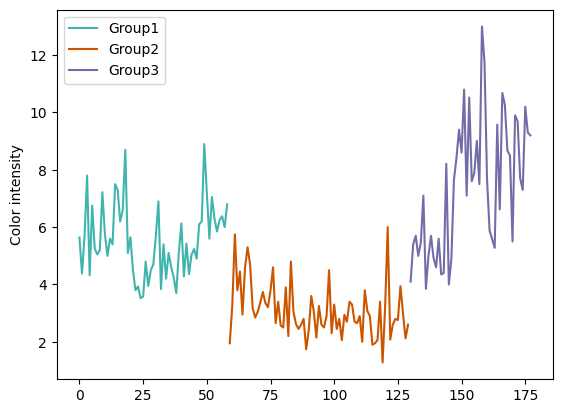

In [25]:
sns.lineplot(group1["Color intensity"],label= "Group1", color= "#40B5AD")
sns.lineplot(group2["Color intensity"],label= "Group2", color= "#CC5500")
sns.lineplot(group3["Color intensity"],label= "Group3", color= "#726da8")

# Histogram

The histogram displayed below provides valuable insights into which target group has the highest percentage of wine. Notably, the graph indicates that target group 2 has the highest overall percentage of wine.

This finding is particularly significant, as the grape variety can significantly impact the alcohol percentage of the wine. Therefore, the higher percentage of alcohol in wines from target group 2 suggests that they likely share a similar origin.

Overall, the histogram is an effective tool for visualizing and analyzing the percentage of wine in each target group, providing a basis for further research and highlighting the potential importance of grape variety in determining alcohol content.

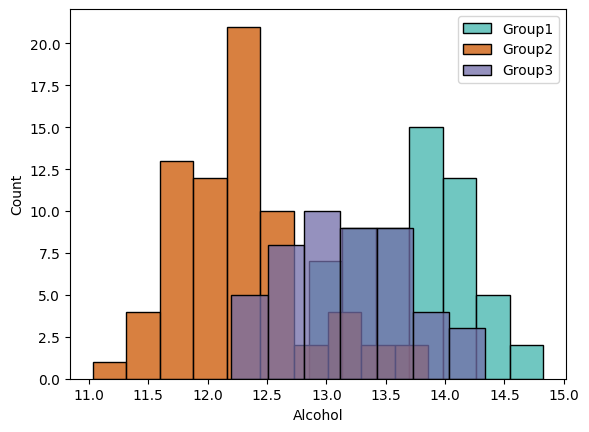

In [26]:

sns.color_palette("rocket", as_cmap=True)

palette_color = sns.color_palette("rocket")

sns.histplot(group1["Alcohol"], label= "Group1", color= "#40B5AD")
sns.histplot(group2["Alcohol"],  label= "Group2", color= "#CC5500")
sns.histplot(group3["Alcohol"], label= "Group3", color= "#726da8")


plt.legend()
plt.show()

# 3. Build the Models

# Splitting the data in into train and test sets

Below the data has been trained and test set. The purpose of the train set is to train the model to learn patterns and relationships in the data, while the test set is used to evaluate the performance of the model on new, unseen data.

The train set is used to fit the model's parameters, which involves finding the values of the model's coefficients that best fit the data. This is done by minimizing the difference between the model's predictions and the actual values in the training data.

In [35]:
import numpy as np
from sklearn.model_selection import train_test_split

np.random.seed()
# train-test split: 80/20
# Extract input and out data from the dataframe
# split the data into train-test sets
train_frame, test_frame = train_test_split(wine, test_size=0.2, shuffle=True)


In [36]:

def create_scatter_graph(data_frame):
    sns.pairplot(data_frame,
             hue="Target",
             palette=sns.color_palette("rocket", 3)
             )

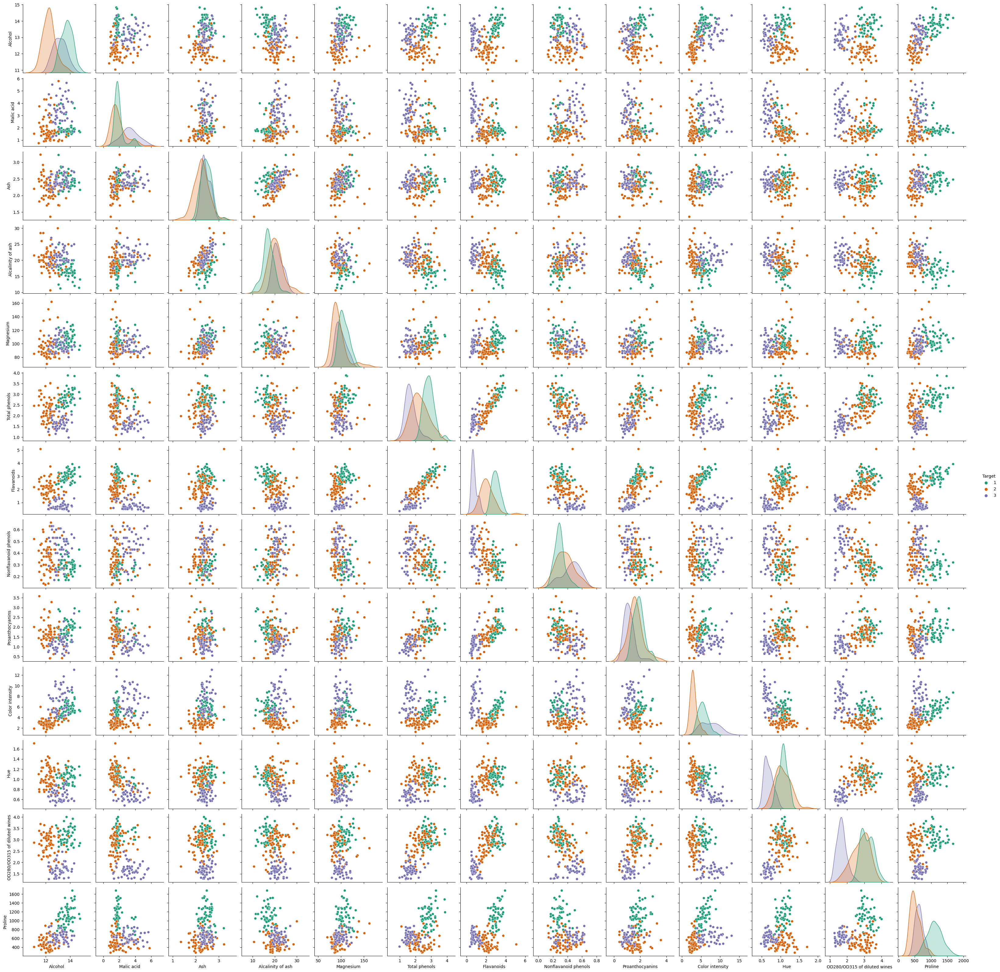

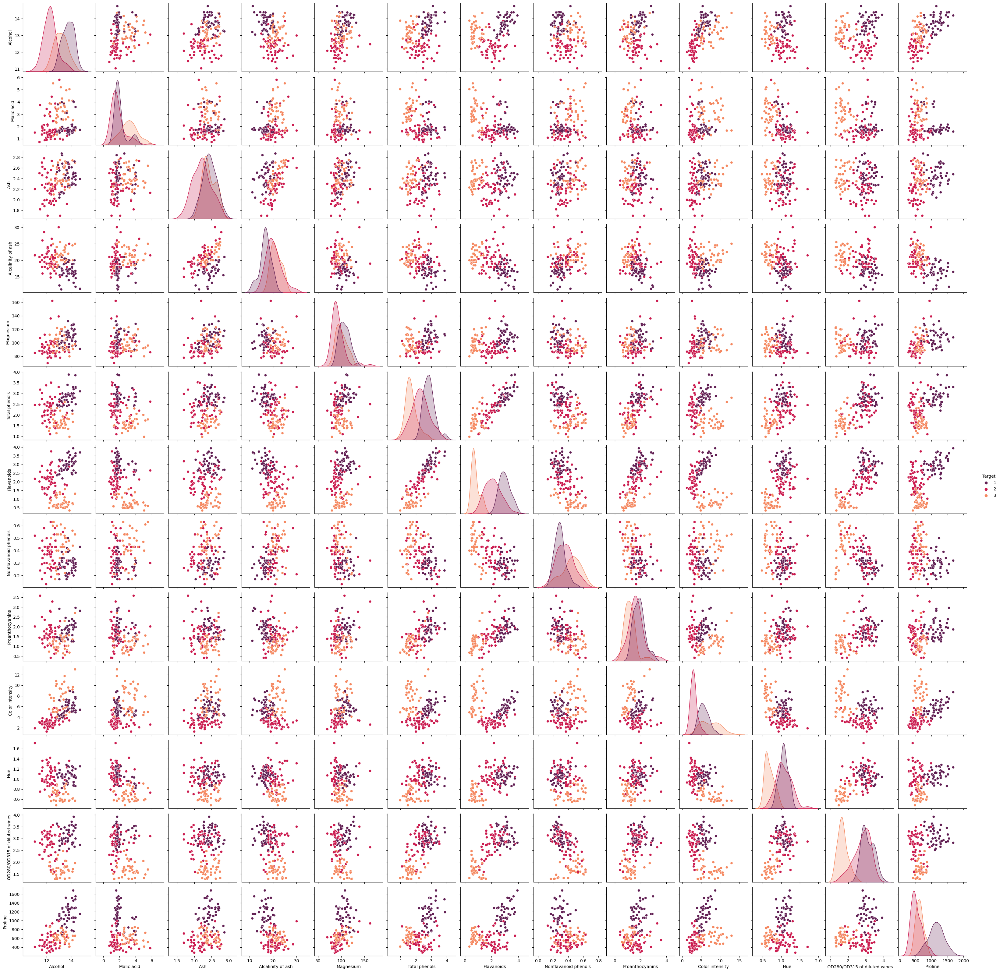

In [37]:
# Visualise the scatterplot matrix: training data

sns.color_palette("crest", as_cmap=True)
sns.pairplot(wine, hue= "Target", palette="Dark2")

create_scatter_graph(train_frame)

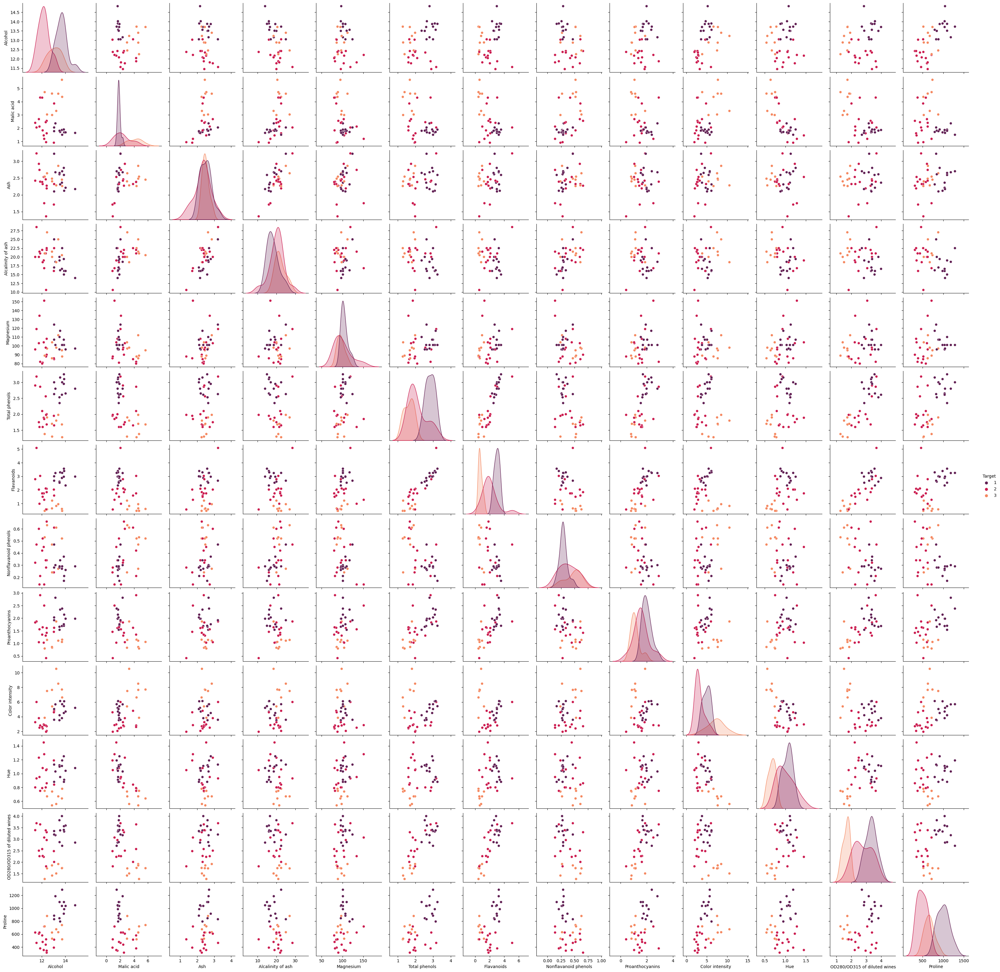

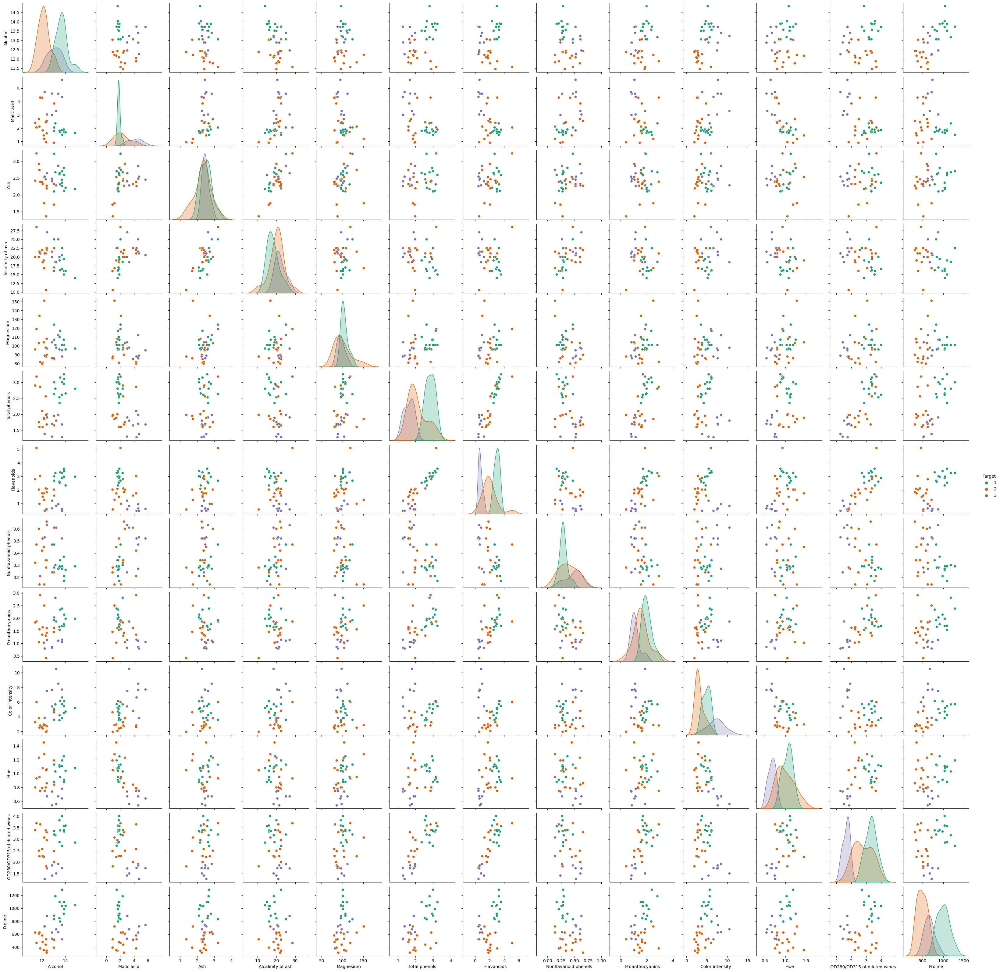

In [40]:
# Visualise the scatterplot matrix: testing data
create_scatter_graph(test_frame)

sns.pairplot(test_frame, hue="Target", palette=sns.color_palette("Dark2", 3))

# Decision Tree

A decision tree is commonly used in data analysis for classification and regression problems. Its purpose is to learn a sequence of decisions or rules from the data to make predictions about the target variable. The algorithm works by recursively partitioning the data into subsets based on the value of input features until the data are split into subsets that are as similar as possible with respect to the target variable. The resulting tree can be visualized as a set of nested if-else statements. Decision trees are easy to interpret, can handle both categorical and continuous input features, and can capture nonlinear relationships.

In [65]:
from sklearn import tree

train_feature_frame = train_frame.drop(["Target"], axis=1)
train_label_frame = train_frame["Target"] 

# Creates Decision Tree classifier Object
decision_tree = tree.DecisionTreeClassifier()


In [66]:
# Train decision tree classifier
decision_tree = decision_tree.fit(train_feature_frame, 
                                  train_label_frame)

|--- Color intensity <= 3.46
|   |--- class: 2
|--- Color intensity >  3.46
|   |--- Flavanoids <= 1.68
|   |   |---  Hue <= 0.97
|   |   |   |--- class: 3
|   |   |---  Hue >  0.97
|   |   |   |--- class: 2
|   |--- Flavanoids >  1.68
|   |   |--- Proline <= 679.00
|   |   |   |--- class: 2
|   |   |--- Proline >  679.00
|   |   |   |--- class: 1



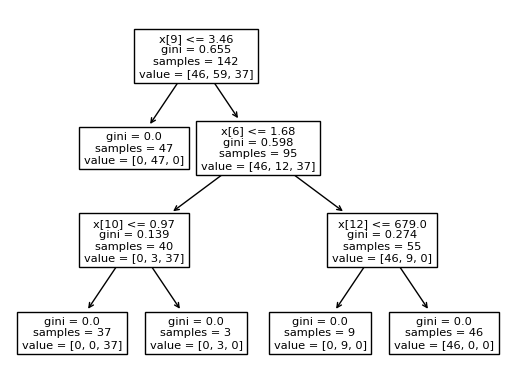

In [67]:
# visualise the tree by printing the string returned by the model's export_tree method.

# Plot output tree
tree.plot_tree(decision_tree)

print(tree.export_text(decision_tree, feature_names=list(feature_frame.columns)))

### Analysis of Decision tree

Upon analysis of the decision tree, it can be observed that the model primarily focuses on the following attributes: color intensity, OD280/OD315 of diluted wines, flavanoids, proanthocyanins, proline, and magnesium. Depending on the attribute values of the wine, the model assigns it to one of the three classes represented by the numbers 1, 2, and 3.

The decision tree suggests that wines with color intensity less than or equal to 3.82 are classified as class 2 if their OD280/OD315 of diluted wines is less than or equal to 3.69 and class 1 if it is greater than 3.69. On the other hand, wines with color intensity greater than 3.82 are classified as class 2 if their flavanoid content is less than or equal to 1.79 and proanthocyanins content is less than or equal to 0.63. Wines with flavanoid content greater than 1.79 and proline content less than or equal to 737.00 are classified as class 2 if their magnesium content is less than or equal to 100.50 and class 1 if it is greater than 100.50. Wines with proline content greater than 737.00 are classified as class 1.

Overall, the decision tree provides a clear and concise method for classifying wines based on their attributes. However, it is important to note that the accuracy and reliability of the model depend heavily on the quality and representativeness of the training data. Further testing and evaluation may be necessary to determine the efficacy of this model.

# Confusion Matrix and Accuracy.

The use of confusion matrix and accuracy in data analysis is to help assess how well a classification model is performing and to identify any weaknesses or issues that need to be addressed. The confusion matrix summarizes the predictions made by the model compared to the actual values in the test set, and it has four components: true positives, false positives, true negatives, and false negatives. Accuracy measures how often the model makes correct predictions, and it is calculated as the ratio of the number of correct predictions to the total number of predictions. While accuracy is useful, it can be misleading in cases where the classes are imbalanced such as Target 1. Metrics such as, precision, recall, and F1 score can be used to assess model performance and identify weaknesses or issues that need to be addressed.

In [68]:
# prediction for the first test input array
test_feature_frame = test_frame.drop(["Target"], axis=1)
test_label_frame = test_frame["Target"]

print(decision_tree.predict(test_feature_frame.iloc[:1]))


[1]


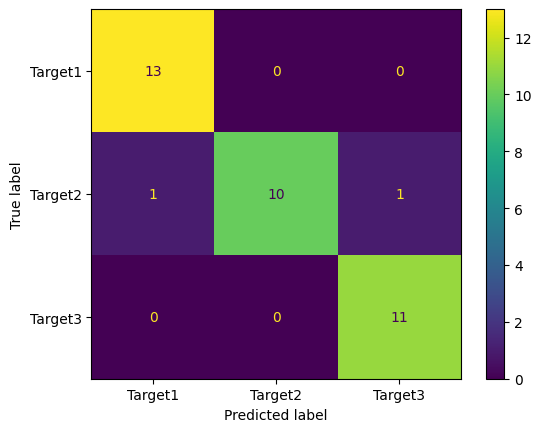

Decision Tree Accuracy: 0.9444444444444444


In [69]:
from sklearn.metrics import ConfusionMatrixDisplay, accuracy_score, confusion_matrix

# report confusion matrix and accuracy
predictions = decision_tree.predict(test_feature_frame)
cm = confusion_matrix(test_label_frame, predictions)
accuracy = accuracy_score(test_label_frame, predictions)


# visualise the confusion matrix with ConfusionMatrixDisplay
disp = ConfusionMatrixDisplay(cm, display_labels=["Target1", "Target2", "Target3"])
disp.plot()
plt.show()

print(f"Decision Tree Accuracy: {accuracy}")


### Analysis of Confusion Matrix and Accuracy

Based on the results of the confusion matrix, the model has performed fairly well. The majority of the predicted values are correctly classified, with only a few false and false negatives. The precision of the confusion matrix and recall scores are both relatively high, indicating that the model is accurately identifying the positive and negative cases. overall, it looks like there may be room for improvement in reducing the number of false positives and false negatives which mainly came from Target 1.

## Classification and Clustering 

Clustering is an unsupervised machine learning technique used to group similar data points together based on their features or characteristics. The goal of clustering is to find natural groupings or clusters in the data without any prior knowledge of the labels or classes of the data. Clustering algorithms such as k-means, hierarchical clustering, and density-based clustering, among others, are used to partition the data into groups based on the similarity between data points.

Classification, on the other hand, is a supervised machine learning technique used to predict the class or label of a new data point based on its features. The goal of classification is to learn a mapping between the input features and the output labels from a labeled training dataset. Classification algorithms such as logistic regression, decision trees, random forests, and support vector machines, among others, are used to train models to predict the label or class of new data points.

The main difference between clustering and classification is that clustering is used for unsupervised learning, where the goal is to find patterns in the data without any prior knowledge of the labels or classes, while classification is used for supervised learning, where the goal is to predict the label or class of new data points based on labeled training data.

In summary, clustering is used to group similar data points together based on their features or characteristics, while classification is used to predict the class or label of new data points based on their features and labeled training data. Both techniques are important in data analysis and are used in a variety of applications such as customer segmentation, fraud detection, image recognition, and many others.

In [70]:
# scale data -- use all data

from sklearn.preprocessing import StandardScaler

feature_frame = wine.drop(["Target"], axis=1)

scaler = StandardScaler()
scaler.fit(feature_frame)
feature_scaled = scaler.transform(feature_frame)

### K-means model

In [71]:
# Instantiate KMeans model
from sklearn.cluster import KMeans
model = KMeans(n_clusters=2, init="random", n_init=1)

# Fit model to data
model = model.fit(feature_scaled)

In [72]:
from sklearn.metrics import silhouette_score
# evaluate performance by printing the silhouette score

score = silhouette_score(feature_scaled, model.labels_)
print(f"Silouette Score: {score}")

# is this good or bad? How can you tell?

# This is not good as a score around 0 suggests overlapping clusters, which is not
# useful 

Silouette Score: 0.26831340971052126


In [73]:
# make predictions on the dataset
kmeans_predictions = model.predict(feature_scaled)

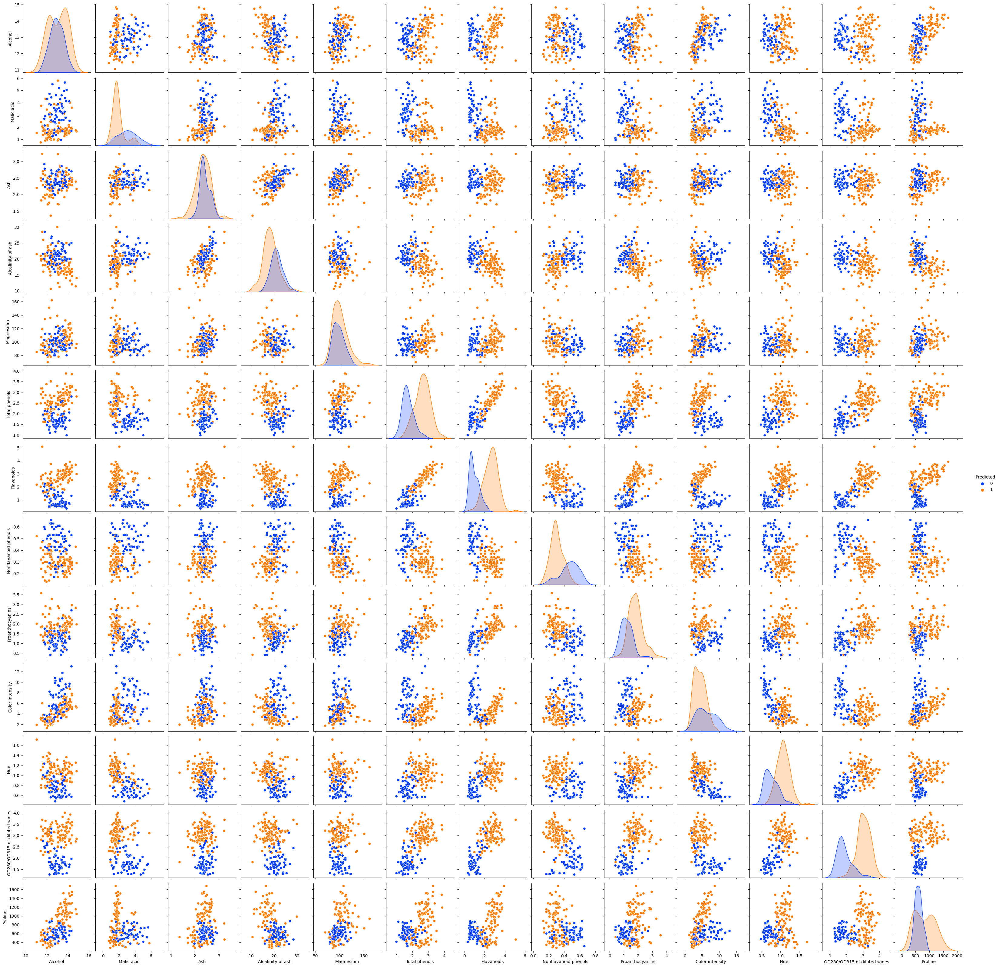

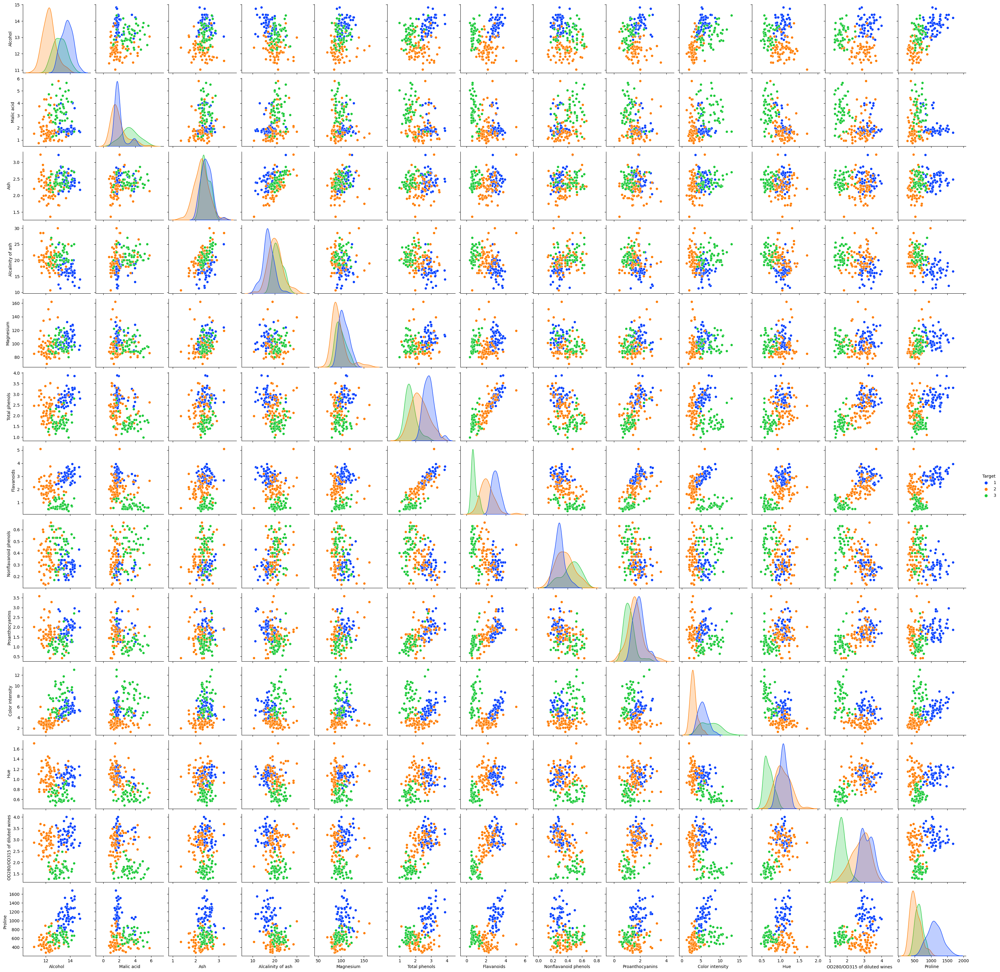

In [74]:
# construct dataframe containing the clustered information
feature_frame["Predicted"] = pd.DataFrame(kmeans_predictions)

# plot coloured with cluster id
sns.pairplot(feature_frame, hue="Predicted", palette=sns.color_palette("bright", 2))

# plot coloured with original labels
sns.pairplot(wine, hue="Target", palette=sns.color_palette("bright", 3))

# 4. Discussion of Results

After analyzing the results of the wine classification model, several conclusions have emerged regarding the feasibility of identifying the origin of a particular bottle of wine. The model uses attributes such as color intensity, OD280/OD315, flavanoids, proanthocyanins, proline, and magnesium to classify wines into three targets.

Notably, Target 1 had the most significant representation, accounting for a substantial portion of the dataset. This may have influenced other outcomes, given its overall dominance. However, the histogram and line plot reveal that Target 3 has the most color intensity, while Target 2 has the highest concentration of alcohol. This information is crucial in identifying the origin of a particular bottle of wine.

While the scatterplots presented useful comparison results, we must consider the unfair bias that Target 1 posed. Different amounts of data were collected from each cultivator, which may have resulted in some inaccurate results. To overcome this bias, the list plot and histogram were effective in highlighting which targets had the highest percentage of alcohol and color intensities, both of which are crucial attributes in identifying the origin of a particular bottle of wine. These visualizations effectively eliminated the bias that Target 1 had, making them more reliable indicators of the origin of the wine.

The decision tree model was an effective visualization that primarily focused on attributes like color intensity, OD280/OD315, flavanoids, proanthocyanins, proline, and magnesium. Wines are classified into three target based on their attribute values. Wines with color intensity less than or equal to 3.82 are classified as target 2 if their OD280/OD315 is less than or equal to 3.69 and target 1 if it is greater than 3.69. Wines with color intensity greater than 3.82 are classified as target 2 if their flavanoid and proanthocyanins content is less than or equal to 1.79 and 0.63 respectively. Wines with high proline content are classified as target 1. 

Out of the two models chosen, the confusion matrix proved to be the most accurate whereas the classification and clustering fell short of provding reasonable predictions. Furthermore, clustering and classification have several limitations to consider. Some of these limitations include subjectivity in the choice of algorithm and number of clusters or classes, overfitting to the training data, sensitivity to outliers, limited interpretability, and dependence on labeled data.



# 5. Conclusion
In conclusion, in order to enhance the accuracy of the results, it would be advisable to gather an equal number of data samples from each cultivator. This approach guarantees that there is no bias or unreliability in the results. Unequal sample sizes among groups can compromise the statistical power of the analysis, which can potentially result in inaccurate conclusions.

Furthermore, in place of clustering and classification, a GMM model could be used in its place. A Gaussian mixture model (GMM) would have been more effective and accurate. GMM can model data as a mixture of Gaussian distributions, which is suitable for identifying overlapping clusters in the wine chemical attribute data. Since different types of wine can have similar chemical properties, GMM could be useful in identifying these similarities and grouping wines accordingly.

Overall, the various attributes of wine are interconnected and can impact one another in complex ways, contributing to the overall quality and character of the wine.
Alcohol content can impact the color and aroma of wine, as well as its flavor and mouthfeel.
Malic acid levels can influence the taste and acidity of wine, which can impact the flavor and texture of the wine.
Total phenols, flavanoids, and proanthocyanins are all compounds found in the skins and seeds of grapes and can affect the color of wine.
Color intensity can be influenced by total phenols, flavanoids, and proanthocyanins, as well as the length of time the grape skins remain in contact with the juice during fermentation.
The hue of wine can be affected by the pH level, which is influenced by the acidity of the wine and the presence of other compounds such as malic acid.
The OD280/OD315 ratio of diluted wines can be used as a measure of protein content in wine, which can be influenced by the fining process used during production.
Proline levels can impact the aroma and flavor of wine, and are sometimes used as an indicator of grape ripeness.


Finally, the data analysis conducted above reveals evidence that the characteristics and attributes of a bottle of wine can be used to pinpoint its origin with a high degree of accuracy. By analyzing factors such as alcohol concentration, color intensity, flavanoids content and so on, it becomes possible to classify a wine as belonging to target group 1, 2, or 3. These findings not only confirm the possibility of identifying the origin of a bottle of wine but also demonstrate the importance of paying close attention to the unique features of each wine batch. This knowledge can be particularly valuable to wine industry professionals, from winemakers to distributors and retailers, in helping them make informed decisions about wine sourcing and selection.



# 6. References

### The history of wine making and highest producer
VinYang (January 27th 2023)
https://www.google.com/url?sa=t&rct=j&q=&esrc=s&source=web&cd=&cad=rja&uact=8&ved=2ahUKEwi_55f_g8v-AhXPbsAKHXfPAPwQFnoECBUQAw&url=https%3A%2F%2Fvinyang.com%2Fblog%2Fwine-by-country%23%3A~%3Atext%3D1.-%2CItaly%2Cmost%2520wine%2520in%2520the%2520world.&usg=AOvVaw3zsGNxzYULWg4BSDfx9fBK

Jackie Wynne (no date), History of Wine 
https://www.arenaflowers.com/pages/history-of-wine/#:~:text=Carbon%20dating%20confirmed%20the%20wine,domestication%20of%20animals%20and%20plants. 

### How Different Regions of the World Affect the Taste of Wine
https://www.google.com/url?sa=t&rct=j&q=&esrc=s&source=web&cd=&ved=2ahUKEwi15bOJ0bD-AhXYgVwKHaNlBtMQFnoECA0QAw&url=https%3A%2F%2Fperrinesproduce.com%2Fhow-different-regions-of-the-world-affect-the-taste-of-wine%2F%23%3A~%3Atext%3DSpecifically%252C%2520the%2520climate%252C%2520soil%2520and%2Cacidic%2520a%2520wine%2520will%2520become.&usg=AOvVaw1lRRh6sw1YJlVmIYw_zMrc

https://www.google.com/url?sa=t&rct=j&q=&esrc=s&source=web&cd=&cad=rja&uact=8&ved=2ahUKEwity_370LD-AhXLgVwKHUovDEUQFnoECAsQAQ&url=https%3A%2F%2Fwww.wine-tastings-guide.com%2Fwine-regions.html&usg=AOvVaw0WCGrgF5ZlIcI42vktQLZ3


### How geography affects wine style 
WSET Global, (August 24 2021), How does geography affect a wine’s style?
https://www.google.com/url?sa=t&rct=j&q=&esrc=s&source=web&cd=&cad=rja&uact=8&ved=2ahUKEwjZsNf_2rD-AhUaiVwKHXVgBtoQFnoECAoQAw&url=https%3A%2F%2Fwww.wsetglobal.com%2Fknowledge-centre%2Fblog%2F2021%2Faugust%2F24%2Fhow-does-geography-affect-a-wine-s-style%2F%23%3A~%3Atext%3DAlongside%2520latitude%252C%2520many%2520other%2520factors%2Cdifference%2520to%2520the%2520final%2520wine.&usg=AOvVaw3aBj1opujVp6iITr_1YNkS



